# Unzip dataset


In [ ]:
!unzip -q /content/train_data.zip

#Clone YOLO-V5 files from official repository

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

In [ ]:
%cd yolov5/

/content/yolov5


#Install dependencies

In [ ]:
!pip install -r requirements.txt

# Prepare .yaml file:
1. Open coco128.yaml in yolov5/data/
2. Editing the following inside it:
    

      -   Training and Test file path
      -   Number of classes and Class names.



# Train YOLO-V5 model

**Training arguments:**
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs.
- **data:** dataset locaiton.
- **weights:** specify a path to weights to start transfer learning from. 
- **cache:** cache images for faster training

In [ ]:
!python train.py --img 640 --batch 16 --epochs 150 --data coco128.yaml --weights yolov5s.pt --nosave --cache 

train: weights=yolov5s.pt, cfg=, data=coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=640, rect=False, resume=False, nosave=True, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-48-g5f8054c Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, d

# Visualize the training metrics

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

# TESTING

In [ ]:
!python detect.py --source /content/test_data/preprocessedTest --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640 --save-txt --save-conf

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/test_data/preprocessedTest, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-48-g5f8054c Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/115 /content/test_data/preprocessedTest/680.jpg: 640x640 1 signature, 12.6ms
image 2/115 /content/test_data/preprocessedTest/681.jpg: 640x640 1 signature, 12.6ms
image 3/115 /content/test_data/preprocessedTest/682.jpg: 640x640 2 signatures, 12.6ms
image 4/115 /content/test_data/preprocessedTest/683.jpg: 640x

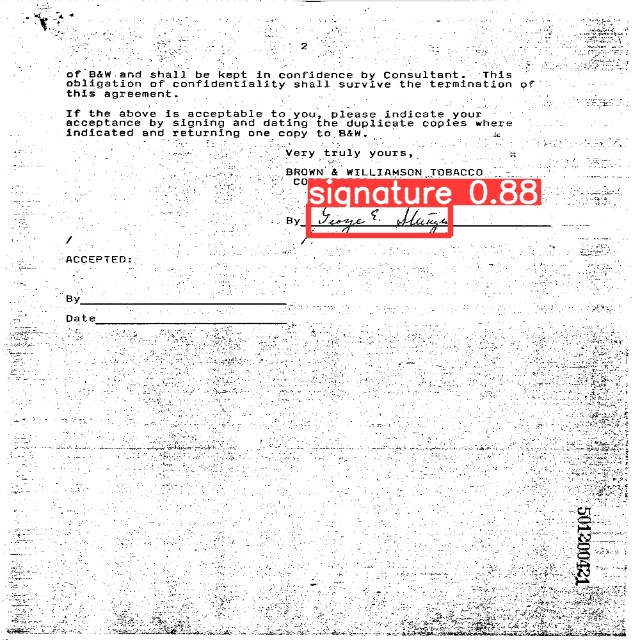

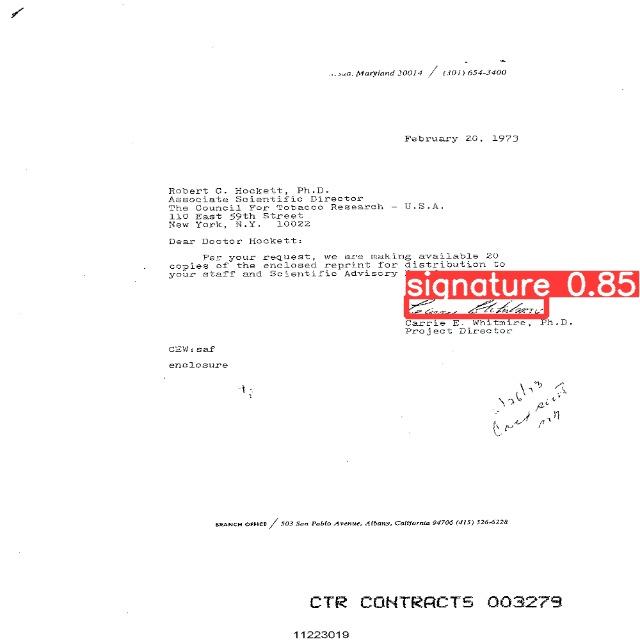

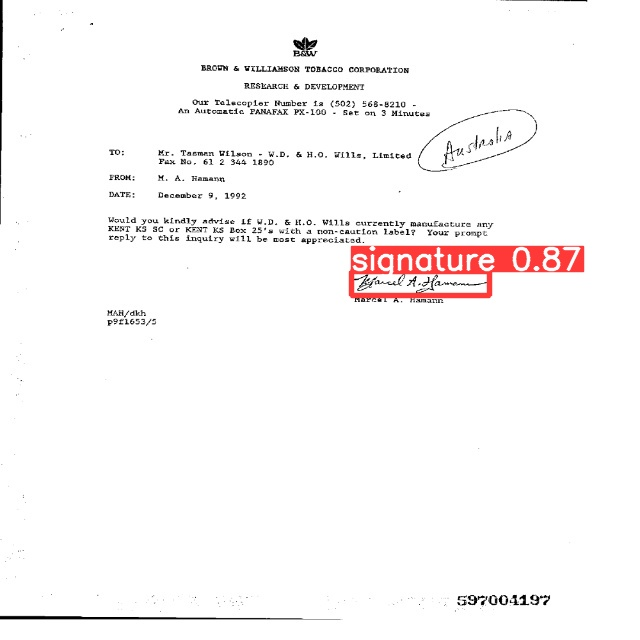

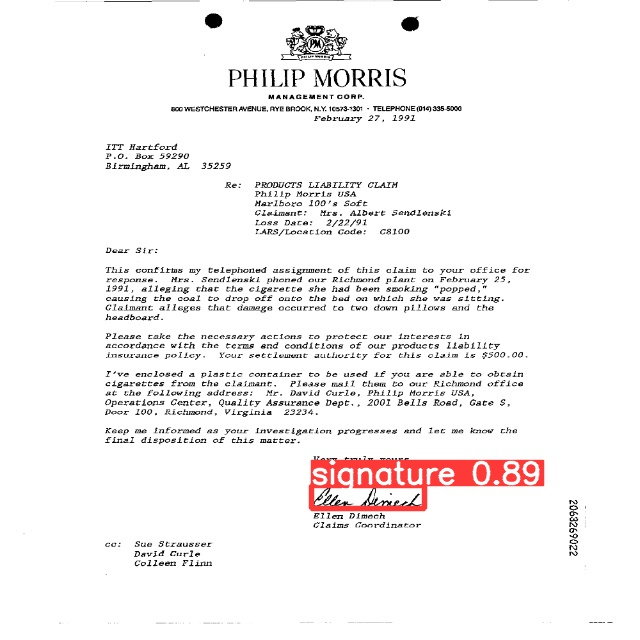

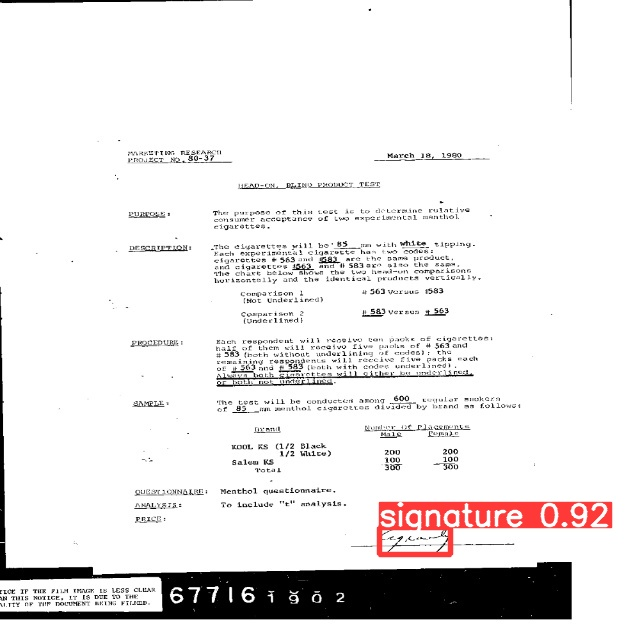

...

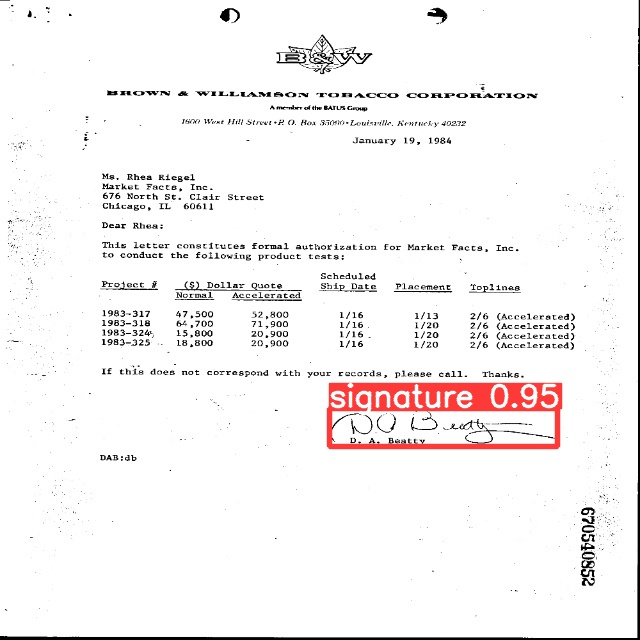

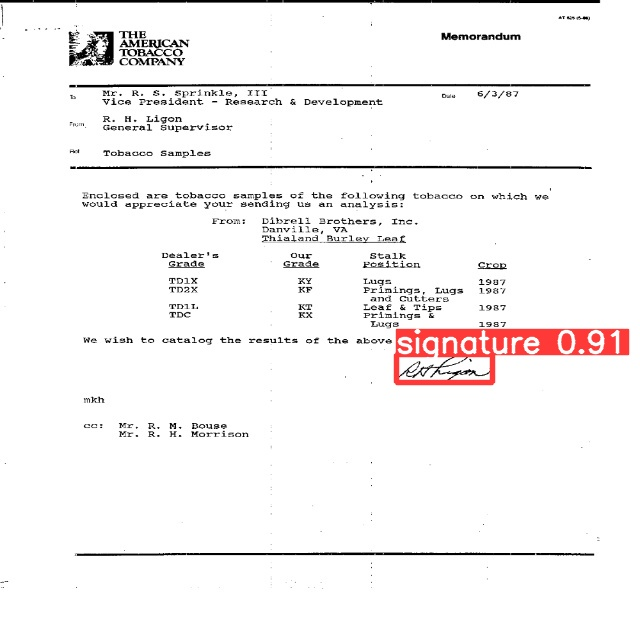

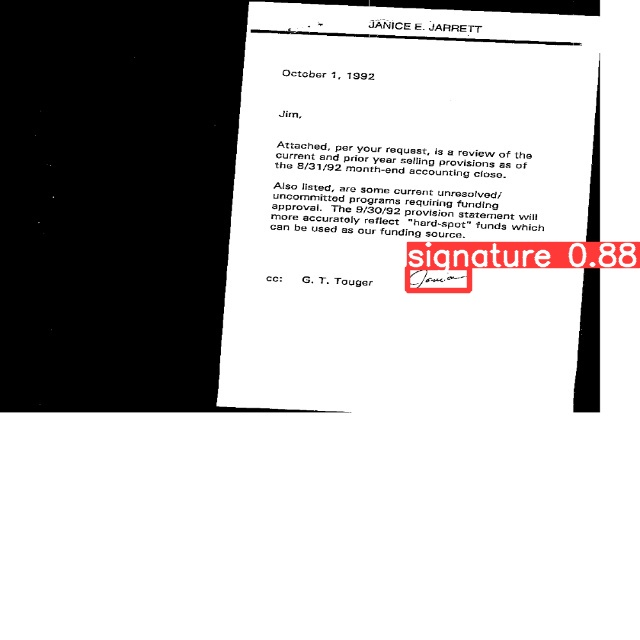

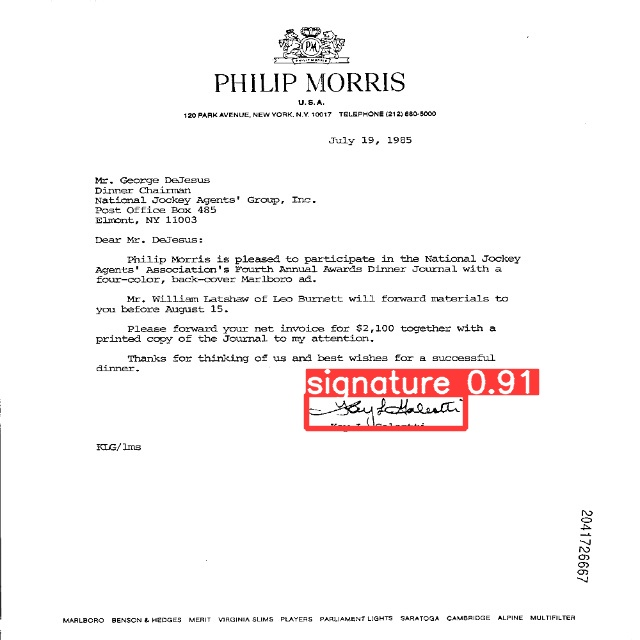

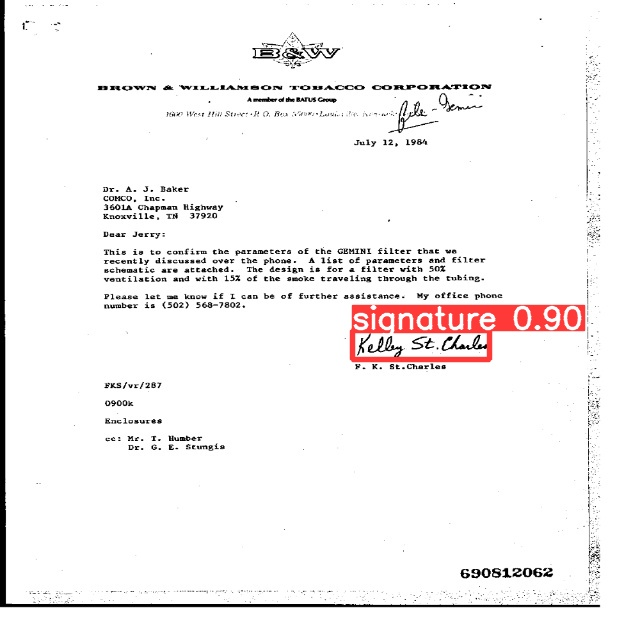

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

# Calculate test metrics

In [ ]:
!python val.py --weights /content/yolov5/runs/train/exp/weights/best.pt --data coco128.yaml --img 640 --task test

val: data=/content/yolov5/data/coco128.yaml, weights=['/content/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-48-g5f8054c Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/train_data/labels/test.cache... 115 images, 0 backgrounds, 0 corrupt: 100% 115/115 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 4/4 [00:04<00:00,  1.11s/it]
                   all        115        130      0.963      0.954       0.98      0.753
Speed: 1.4ms pre-process, 15.0ms inference, 2.2ms NMS per image at shape (32, 3, 640, 640)
Res

# Save weights

In [ ]:
from google.colab import files
files.download('/content/yolov5/runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>